## Analysis of Fixation Patterns


- Question: How can we distinguish between points within the object and outside of the object? $\rightarrow$ Exclude first fixation point for both eyes.

- This task mainly focuses on exploring on statistical differences in the fixation points. That could be
the fixation time, the order (most likely the first fixation point is random or aligns with the
fixation cross before the picture was visible and only after fixation points are within the object? $\rightarrow$ Not random, aligns with fixation cross.
- Does the first point align with image offset/fixation cross? $\rightarrow$ yes!
- Suggestion: If we want to only give one point for SAM, it should be the very last one (see analysis below)

In [1]:
import scipy.io
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
import os
import ast

In [2]:
def calculate_fix_cross_coord(image, offset, screen_resolution = (1680,1050)):
    '''Calculate the fixation cross position relative to the image based on the display offset.'''
    start_x, start_y = offset[0], offset[1]
    center_x, center_y = screen_resolution[0] // 2, screen_resolution[1] // 2
    fix_cross_x = center_x - start_x  # Relative X position
    fix_cross_y = center_y - start_y  # Relative Y position
    return fix_cross_x, fix_cross_y


def plot_arrows_all_viewers(img, offset, fix_points_all_left, fix_points_all_right): # TO DO: handle nan values accordingly! And if there is a nan we should not draw an arrow?
    # Define colors for each viewer: bold color for left, pastel for right
    viewer_colors = [
        {'left': 'red', 'right': 'lightcoral'},
        {'left': 'blue', 'right': 'lightblue'},
        {'left': 'green', 'right': 'lightgreen'},
        {'left': 'purple', 'right': 'plum'},
        {'left': 'orange', 'right': 'peachpuff'}
    ]

    # Plot fixation points for all viewers
    plt.figure(figsize=(15, 15))
    plt.imshow(img)
    plt.title('Fixation Points per Viewer (Left and Right Eyes)')

    fix_cross_x, fix_cross_y = calculate_fix_cross_coord(img, offset)
    
    # Draw the fixation cross
    cross_size = 10
    cross_color = (1, 0, 0)
    plt.plot([fix_cross_x - cross_size, fix_cross_x + cross_size], [fix_cross_y, fix_cross_y], color=cross_color, lw=2)
    plt.plot([fix_cross_x, fix_cross_x], [fix_cross_y - cross_size, fix_cross_y + cross_size], color=cross_color, lw=2)
    
    # Plot fixation points for each viewer with distinct colors for each eye
    for viewer_id in range(1, 6): 
        # Get fixation points for the current viewer for left and right eyes
        viewer_left_points = [point[1] for point in fix_points_all_left if point[0] == viewer_id][0] # fixation_points_all_left is a list of tuples for each viewer: [(1, [(x,y)])]
        viewer_right_points = [point[1] for point in fix_points_all_right if point[0] == viewer_id][0]
    
        if viewer_left_points:
            x_left = [point[0] for point in viewer_left_points]
            y_left = [point[1] for point in viewer_left_points]
            plt.scatter(x_left, y_left, color=viewer_colors[viewer_id - 1]['left'], label=f'Viewer {viewer_id} (Left)', s=70)
    
            # Draw arrows between consecutive points for the left eye
            for i in range(1, len(viewer_left_points)):
                x_start, y_start = viewer_left_points[i - 1]  # Unpacking tuple directly
                x_end, y_end = viewer_left_points[i]
                plt.arrow(x_start, y_start, x_end - x_start, y_end - y_start, 
                          color=viewer_colors[viewer_id - 1]['left'], lw=2, 
                          length_includes_head=True, head_width=5)
    
        # Plot right eye fixation points and draw arrows between points
        if viewer_right_points:
            x_right = [point[0] for point in viewer_right_points]
            y_right = [point[1] for point in viewer_right_points]
            plt.scatter(x_right, y_right, color=viewer_colors[viewer_id - 1]['right'], label=f'Viewer {viewer_id} (Right)', s=70)
    
            # Draw arrows between consecutive points for the right eye
            for i in range(1, len(viewer_right_points)):
                x_start, y_start = viewer_right_points[i - 1]  # Unpacking tuple directly
                x_end, y_end = viewer_right_points[i]
                plt.arrow(x_start, y_start, x_end - x_start, y_end - y_start, 
                          color=viewer_colors[viewer_id - 1]['right'], lw=2, 
                          length_includes_head=True, head_width=5)
    
    plt.legend()
    plt.show()


def plot_arrows_for_viewer(img, offset, fix_points_all_left, fix_points_all_right, duration_left, duration_right, viewer_id):
    '''Plots fixation points and arrows for a specific viewer (left and right eyes) and show longer durations of fixation points as larger circles.'''

    # Define colors for each viewer: bold color for left, pastel for right
    viewer_colors = [
        {'left': 'red', 'right': 'lightcoral'},
        {'left': 'blue', 'right': 'lightblue'},
        {'left': 'green', 'right': 'lightgreen'},
        {'left': 'purple', 'right': 'plum'},
        {'left': 'orange', 'right': 'peachpuff'}
    ]

    # Get durations

    viewer_left_durations = [duration for viewer, duration in duration_left if viewer == viewer_id][0]
    viewer_right_durations = [duration for viewer, duration in duration_right if viewer == viewer_id][0]

    # Get fixation points for the current viewer (left and right eyes)
    viewer_left_points = [point[1] for point in fix_points_all_left if point[0] == viewer_id][0] # fix_points_all_left is a list of tuples: [(viewer_id, [(x,y)])]
    viewer_right_points = [point[1] for point in fix_points_all_right if point[0] == viewer_id][0]

    # Plot fixation points for the specific viewer
    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    plt.title(f'Fixation Points for Viewer {viewer_id} (Left and Right Eyes)')

    fix_cross_x, fix_cross_y = calculate_fix_cross_coord(img, offset)
    
    # Draw the fixation cross
    cross_size = 10
    cross_color = (1, 0, 0)
    plt.plot([fix_cross_x - cross_size, fix_cross_x + cross_size], [fix_cross_y, fix_cross_y], color=cross_color, lw=2)
    plt.plot([fix_cross_x, fix_cross_x], [fix_cross_y - cross_size, fix_cross_y + cross_size], color=cross_color, lw=2)
    
    # Plot left eye fixation points and draw arrows between points
    if viewer_left_points:
        x_left = [point[0] for point in viewer_left_points]
        y_left = [point[1] for point in viewer_left_points]
        
        # Map durations to circle sizes (scaling)
        min_size = 50  # Minimum circle size
        max_size = 500  # Maximum circle size
        sizes_left = np.interp(viewer_left_durations, (min(viewer_left_durations), max(viewer_left_durations)), (min_size, max_size)) # Scale fixation durations to circle sizes, mapping the duration range to the size range
        # Scatter plot with variable size based on duration
        plt.scatter(x_left, y_left, color=viewer_colors[viewer_id - 1]['left'], label=f'Viewer {viewer_id} (Left)', s=sizes_left)
    
        # Draw arrows between consecutive points for the left eye
        for i in range(1, len(viewer_left_points)):
            x_start, y_start = viewer_left_points[i - 1]  # Unpacking tuple directly
            x_end, y_end = viewer_left_points[i]
            plt.arrow(x_start, y_start, x_end - x_start, y_end - y_start, 
                      color=viewer_colors[viewer_id - 1]['left'], lw=2, 
                      length_includes_head=True, head_width=5)

    # Plot right eye fixation points and draw arrows between points
    if viewer_right_points:
        x_right = [point[0] for point in viewer_right_points]
        y_right = [point[1] for point in viewer_right_points]
        
        # Map durations to circle sizes (scaling)
        sizes_right = np.interp(viewer_right_durations, (min(viewer_right_durations), max(viewer_right_durations)), (min_size, max_size)) # Scale fixation durations to circle sizes, mapping the duration range to the size range
        
        # Scatter plot with variable size based on duration
        plt.scatter(x_right, y_right, color=viewer_colors[viewer_id - 1]['right'], label=f'Viewer {viewer_id} (Right)', s=sizes_right)
    
        # Draw arrows between consecutive points for the right eye
        for i in range(1, len(viewer_right_points)):
            x_start, y_start = viewer_right_points[i - 1]  # Unpacking tuple directly
            x_end, y_end = viewer_right_points[i]
            plt.arrow(x_start, y_start, x_end - x_start, y_end - y_start, 
                      color=viewer_colors[viewer_id - 1]['right'], lw=2, 
                      length_includes_head=True, head_width=5)
    
    plt.legend()
    plt.show()

In [3]:
def get_fix_points(image_file_name, df): 
    """
    Extract fixation points, durations, and offset for all viewers of a specific image.

    Parameters:
    - image_file_name (str): The name of the image file to filter (e.g., 'dog_2010_001366').
    - df (DataFrame): The full data frame containing eye-tracking data.

    Returns:
    - offset (list): The offset coordinates for the image.
    - fix_points_all_left (list of tuples): List of tuples (viewer_id, list of fixation points) for the left eye.
    - duration_left (list of tuples): List of tuples (viewer_id, list of durations) for the left eye.
    - fix_points_all_right (list of tuples): List of tuples (viewer_id, list of fixation points) for the right eye.
    - duration_right (list of tuples): List of tuples (viewer_id, list of durations) for the right eye.
    """
    #image_file_name = image_file_name.split('_', 1)[1] 
    image_file_name = image_file_name.split('_', 1)[1].rsplit('.', 1)[0] # remove class prefix and the .jpg file extension
    
    image_data = df[df['image_file'] == image_file_name]
    offset = image_data['offset'].iloc[0]

    fix_points_all_left = []
    duration_left = []
    fix_points_all_right = []
    duration_right = []

    # Loop over each viewer's data for the image
    for _, row in image_data.iterrows():
        viewer_id = row['viewer']
        
        # Append (viewer_id, image_coordinates_left) to the left fixation points list
        fix_points_all_left.append((viewer_id, row['image_coordinates_left']))
        
        # Append (viewer_id, image_duration_left) to the left durations list
        duration_left.append((viewer_id, row['image_duration_left']))
        
        # Append (viewer_id, image_coordinates_right) to the right fixation points list
        fix_points_all_right.append((viewer_id, row['image_coordinates_right']))
        
        # Append (viewer_id, image_duration_right) to the right durations list
        duration_right.append((viewer_id, row['image_duration_right']))
    
    return offset, fix_points_all_left, duration_left, fix_points_all_right, duration_right
    

In [4]:
INPUT_DIR = "/kaggle/input/"
#et_df = pd.read_csv(os.path.join(INPUT_DIR, 'eye-tracking-data/eye_tracking_data.csv'))
et_df = pd.read_pickle(os.path.join(INPUT_DIR, "df-pkl/eye_tracking_data.pkl"))
et_df

,class,image_file,width_height,offset,viewer,response,image_coordinates_left,image_start_end_time_left,image_duration_left,image_coordinates_right,image_start_end_time_right,image_duration_right,screen_coordinates_left,screen_coordinates_right
0,diningtable,2010_001366,"[332, 500]","[715, 279, 1215, 611]",1,1,"[(111.79999999999995, 256.79999999999995), (31...","[(7, 149), (186, 331), (359, 603), (618, 991),...","[142, 145, 244, 373, 514, 436]","[(100.79999999999995, 260.1), (304.70000000000...","[(7, 147), (184, 331), (357, 600), (616, 990),...","[140, 147, 243, 374, 517, 436]","[(826.8, 535.8), (1029.8, 503.8), (961.3, 446....","[(815.8, 539.1), (1019.7, 508.2), (947.9, 446...."
1,diningtable,2010_001366,"[332, 500]","[715, 279, 1215, 611]",2,1,"[(nan, nan), (318.70000000000005, 253.10000000...","[(nan, nan), (802.0, 1165.0), (1197.0, 1654.0)...","[nan, 363.0, 457.0, 291.0, 261.0]","[(213.79999999999995, 194.39999999999998), (31...","[(66, 767), (804, 1166), (1196, 1654), (1689, ...","[701, 362, 458, 289, 265]","[(nan, nan), (1033.7, 532.1), (977.1, 514.1), ...","[(928.8, 473.4), (1025.1, 525.2), (968.7, 507...."
2,diningtable,2010_001366,"[332, 500]","[715, 279, 1215, 611]",3,1,"[(163.20000000000005, 238.60000000000002), (14...","[(7, 105), (123, 265), (301, 582), (605, 993),...","[98, 142, 281, 388, 230]","[(170.5, 233.70000000000005), (153.20000000000...","[(7, 108), (120, 265), (296, 583), (606, 995),...","[101, 145, 287, 389, 229]","[(878.2, 517.6), (858.9, 517.1), (940.8, 435.1...","[(885.5, 512.7), (868.2, 507.0), (945.7, 417.1..."
3,diningtable,2010_001366,"[332, 500]","[715, 279, 1215, 611]",4,1,"[(228.29999999999995, 272.0), (234.20000000000...","[(16, 281), (317, 568), (589, 1115)]","[265, 251, 526]","[(214.89999999999998, 253.89999999999998), (22...","[(15, 283), (305, 568), (587, 1115)]","[268, 263, 528]","[(943.3, 551.0), (949.2, 482.6), (943.7, 527.0)]","[(929.9, 532.9), (937.2, 457.3), (934.3, 505.8)]"
4,diningtable,2010_001366,"[332, 500]","[715, 279, 1215, 611]",5,1,"[(139.29999999999995, 211.7), (218.10000000000...","[(7, 227), (268, 441), (464, 894), (1016, 1741)]","[220, 173, 430, 725]","[(153.60000000000002, 218.39999999999998), (24...","[(7, 227), (270, 440), (464, 894), (1014, 1741)]","[220, 170, 430, 727]","[(854.3, 490.7), (933.1, 406.6), (937.3, 476.0...","[(868.6, 497.4), (955.5, 425.7), (966.7, 475.8..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31345,bicycle,2010_000898,"[333, 500]","[1029, 519, 1529, 852]",1,1,"[(-368.1, 32.799999999999955), (-389.5, 45.299...","[(15, 24), (49, 158), (231, 401), (429, 816)]","[9, 109, 170, 387]","[(-368.79999999999995, 32.39999999999998), (-3...","[(18, 29), (36, 157), (230, 403), (429, 816)]","[11, 121, 173, 387]","[(660.9, 551.8), (639.5, 564.3), (1248.1, 757....","[(660.2, 551.4), (655.3, 556.8), (1240.5, 738...."
31346,bicycle,2010_000898,"[333, 500]","[1029, 519, 1529, 852]",2,1,"[(-224.10000000000002, 24.299999999999955), (n...","[(7.0, 175.0), (nan, nan), (nan, nan), (301.0,...","[168.0, nan, nan, 1050.0, 180.0]","[(-262.9, -20.600000000000023), (-144.20000000...","[(7, 192), (217, 249), (266, 298), (310, 1351)...","[185, 32, 32, 1041, 187]","[(804.9, 543.3), (nan, nan), (nan, nan), (1304...","[(766.1, 498.4), (884.8, 518.4), (1006.6, 560...."
31347,bicycle,2010_000898,"[333, 500]","[1029, 519, 1529, 852]",3,1,"[(-226.79999999999995, 3.8999999999999773), (3...","[(7, 160), (234, 385), (412, 706), (742, 1049)]","[153, 151, 294, 307]","[(-224.20000000000005, -3.3999999999999773), (...","[(7, 159), (223, 387), (417, 708), (738, 1049)]","[152, 164, 291, 311]","[(802.2, 522.9), (1335.0, 744.0), (1373.2, 640...","[(804.8, 515.6), (1331.6, 753.0), (1351.1, 656..."
31348,bicycle,2010_000898,"[333, 500]","[1029, 519, 1529, 852]",4,1,"[(-210.0, 74.5), (200.70000000000005, 165.1000...","[(7.0, 140.0), (200.0, 720.0), (nan, nan)]","[133.0, 520.0, nan]","[(-239.10000000000002, 68.29999999999995), (17...","[(7, 139), (198, 543), (553, 720)]","[132, 34

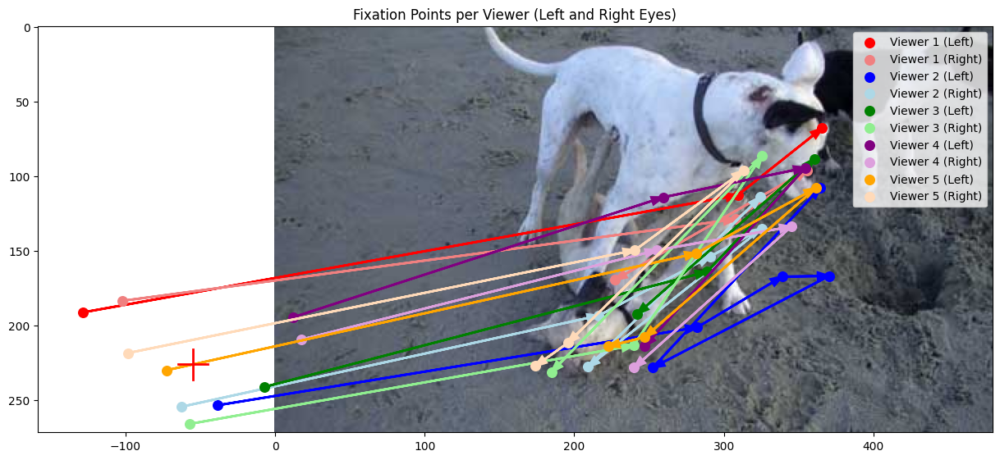

In [5]:
image_folder = os.path.join(INPUT_DIR, "dog-images-subset") 
image_path = os.path.join(image_folder, "dog_2008_000019.jpg")
img = cv2.imread(image_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

offset, fix_points_all_left, duration_left, fix_points_all_right, duration_right = get_fix_points("dog_2008_000019.jpg", et_df) 

plot_arrows_all_viewers(img, offset, fix_points_all_left, fix_points_all_right)

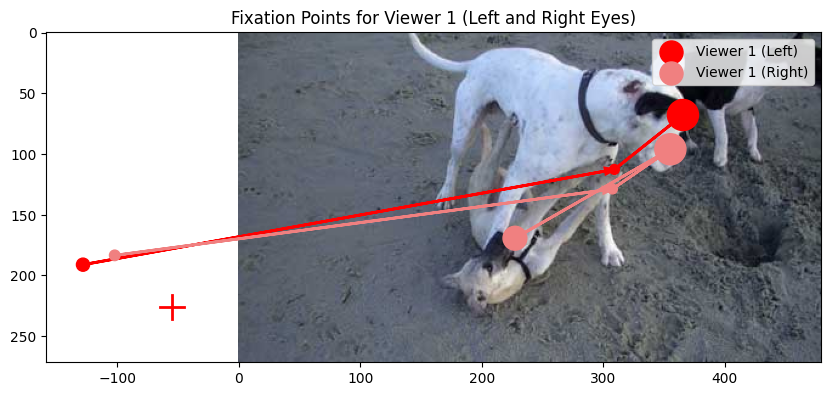

In [6]:
plot_arrows_for_viewer(img, offset, fix_points_all_left, fix_points_all_right, duration_left, duration_right,1) 

### Some observations:

- In the example above, the fixation cross is outside of the image coordinates (and consequently the first fixation points as well).
- Left and right eye movements per participant seem to be very similar (trivially)
- All viewers show a very similar gaze pattern.
- The first fixation point lies around the fixation cross and seems thus uninformative of the object detection task. We can exclude the first fixation point for both eyes. (However, in some cases this is not the case). This could be due to nans? TO DO: check handling of nans!
- Longer duration of fixation points for the last one or two fixation points.
- When comparing several images, the tendency remains the same: longer duration times for the last fixation points. Last fixation points usually on the object itself (with little differences and outliers). This is especially important when there are different objects in one image. Usually, the last fixation point lies on the right object. However, in some cases, the last fixation point is on the other object (I guess it depends on whether a participant looks first. If it is the object already, you do not need to look back after identifying the incorrect object in a second step).
- Even if it is the tendency that the last fixation point lies on the object, sometimes (and not in only a few cases) it lies very close to the object but not in the object itself, which would be a problem for SAM (I guess). There is (trivially) also a difference for the left and right eye. Usually either one of them is within the object, the other lies slightly out of the contours of the object. One might think of averaging positions for both?

### Now let's compare several different images in order to be able to generalize

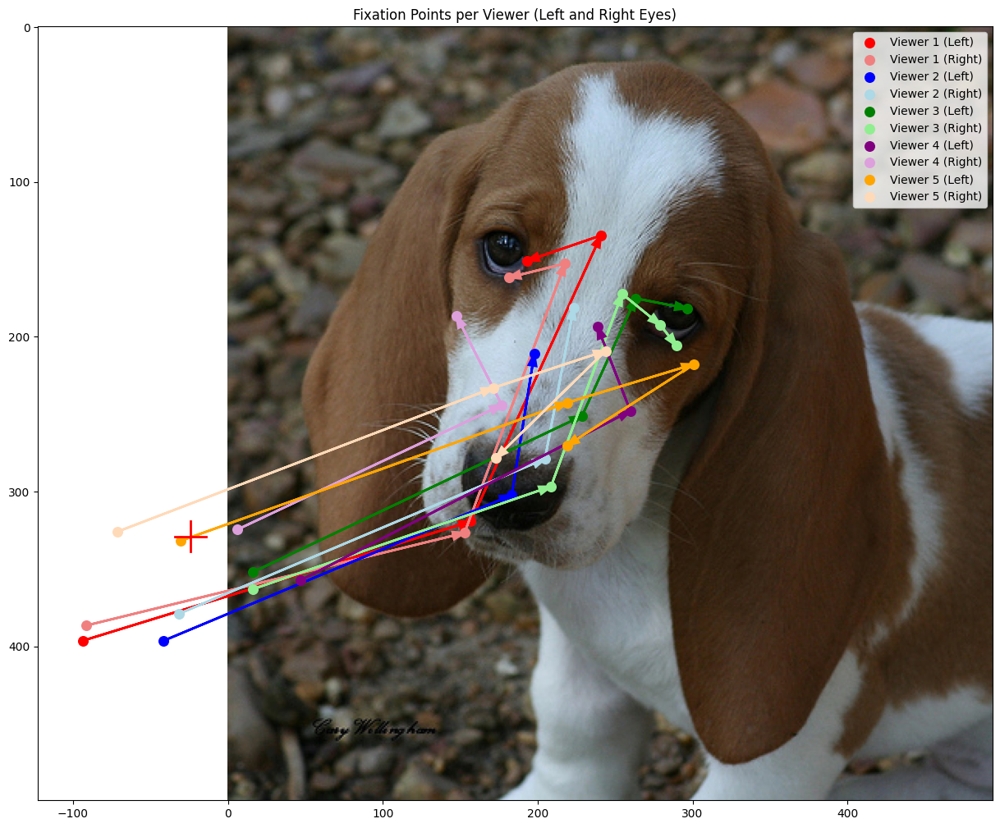

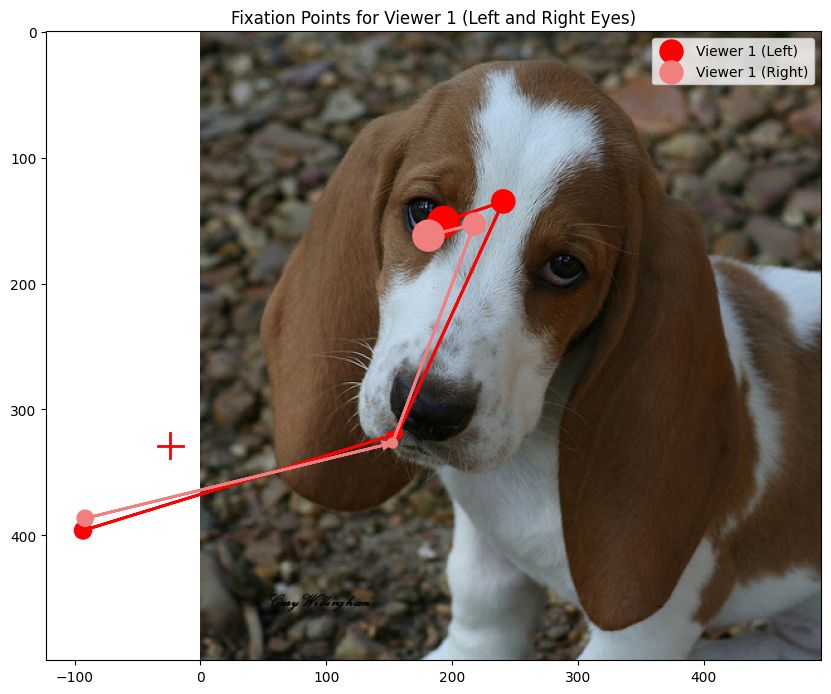

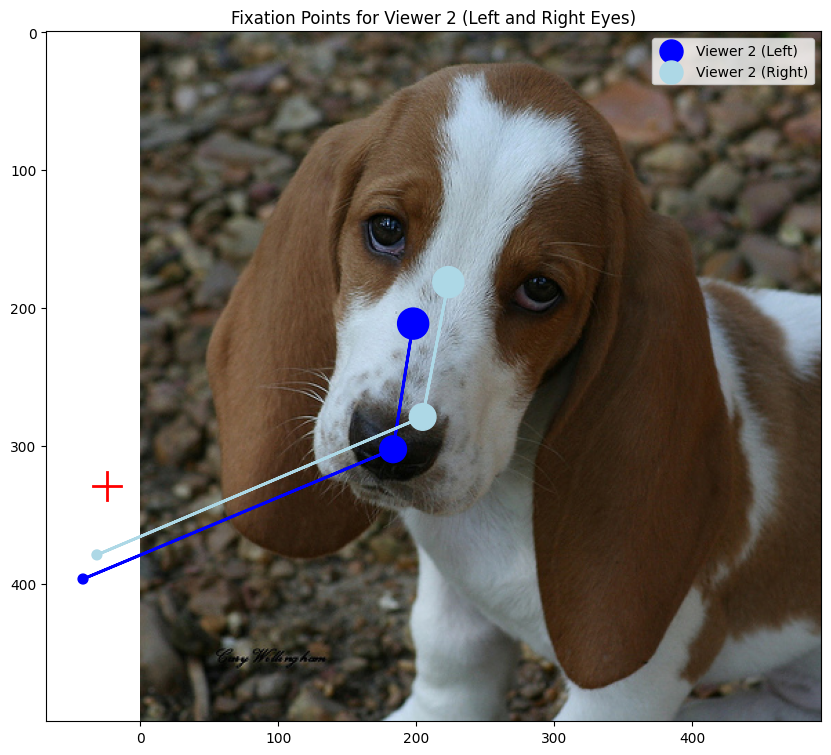

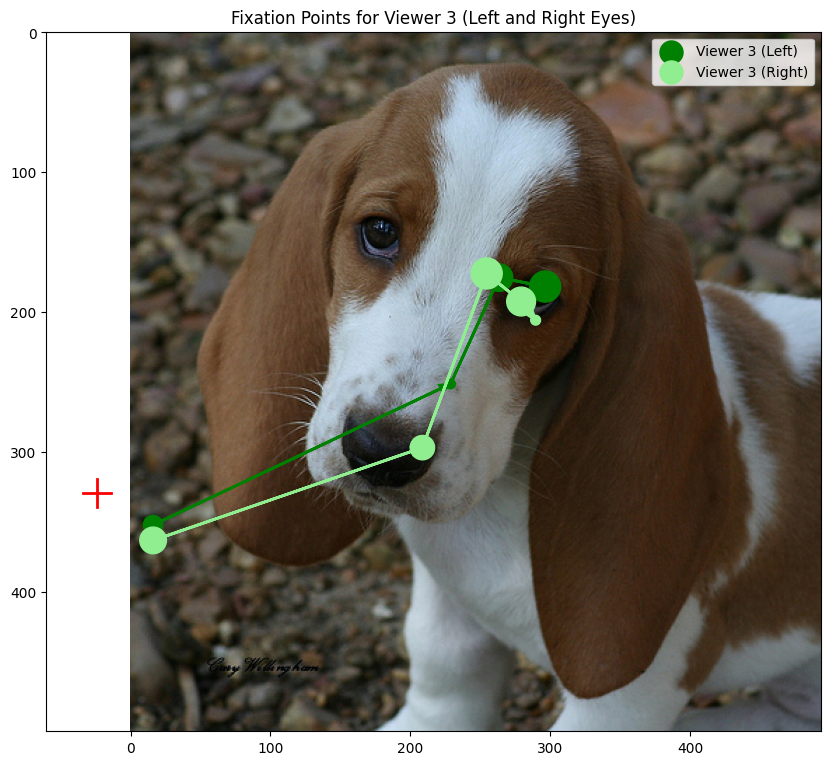

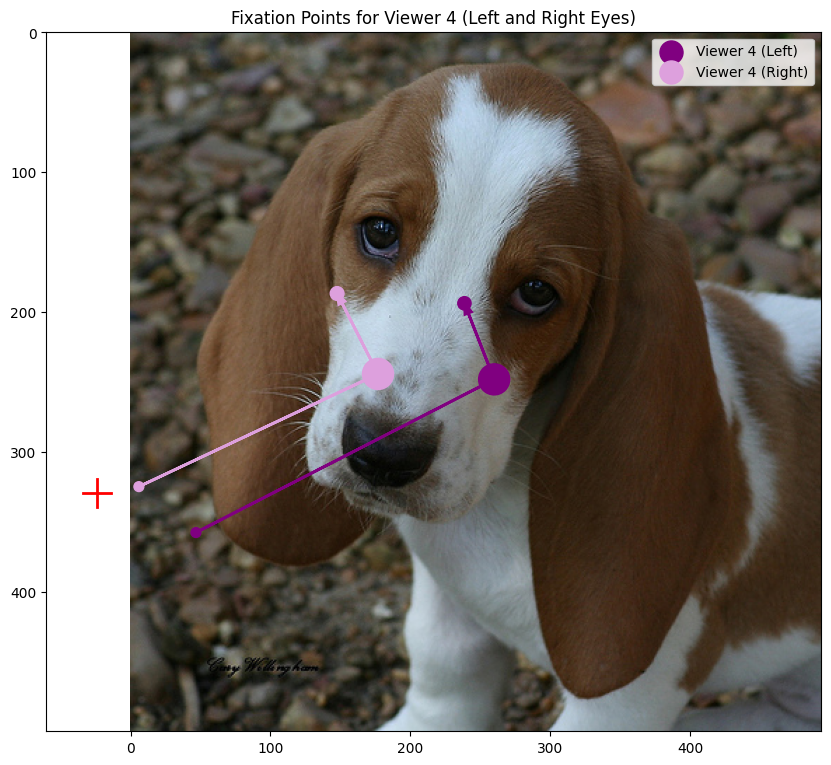

...

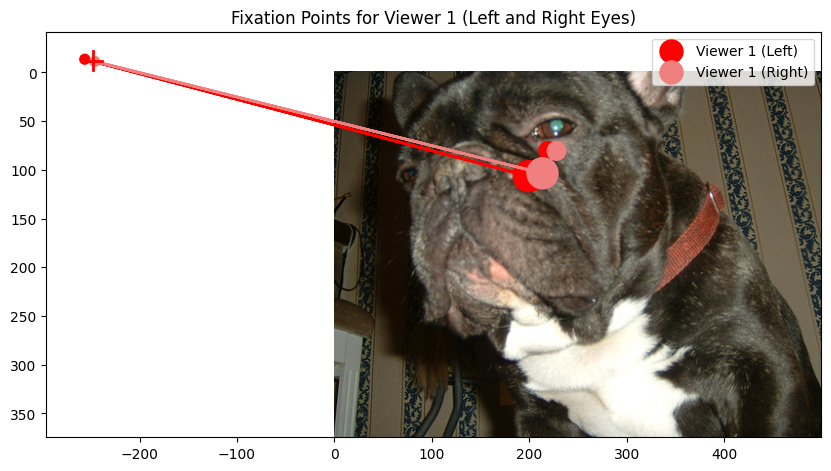

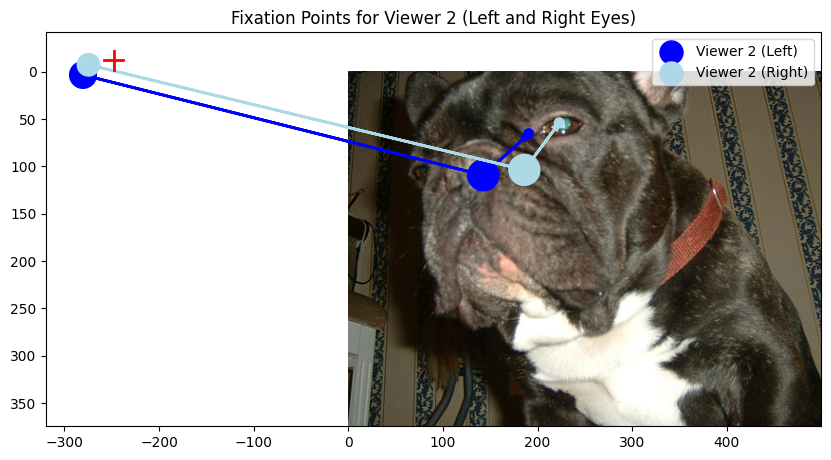

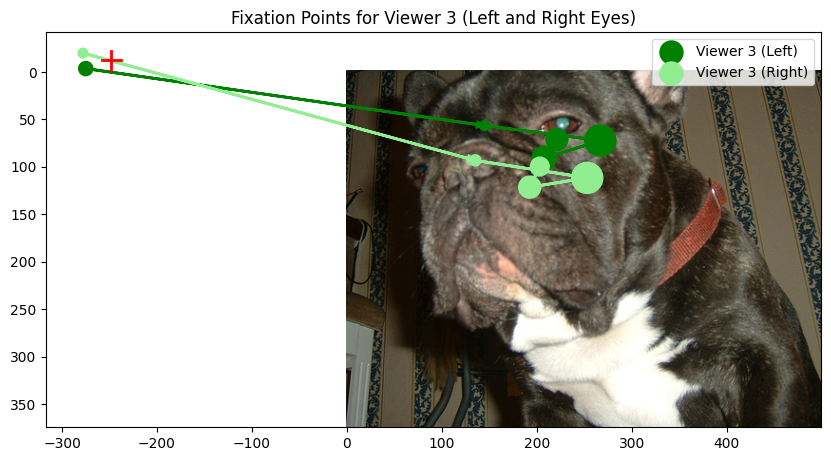

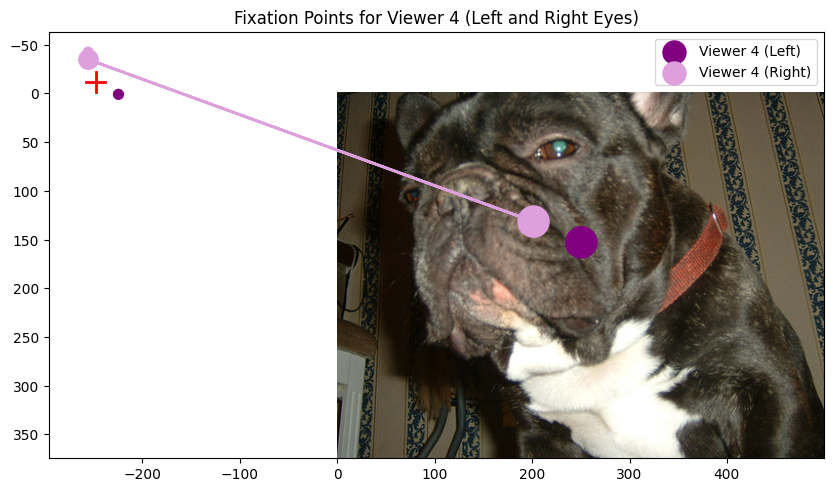

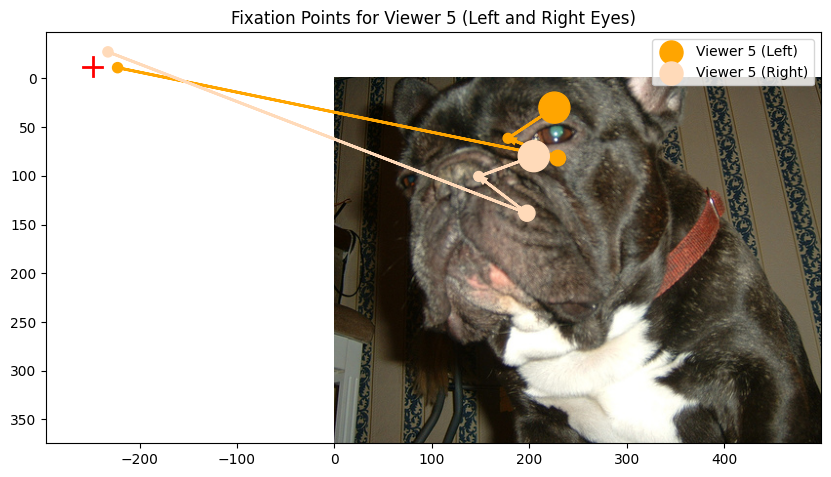

In [7]:
counter = 0
# Iterate over all image files in the folder
for image_filename in os.listdir(image_folder):
    if counter < 5:
        image_path = os.path.join(image_folder, image_filename)
        # Read and convert the image
        img = cv2.imread(image_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            
        # Get fixation points and duration for left and right eyes for the specific image
        offset, fix_points_all_left, duration_left, fix_points_all_right, duration_right = get_fix_points(image_filename, et_df) 
            
        # Plot gaze patterns of all viewers
        plot_arrows_all_viewers(img, offset, fix_points_all_left, fix_points_all_right) 
            
        # Plot gaze patterns for each viewer with duration information
        for viewer in range(1, 6):
            plot_arrows_for_viewer(img, offset, fix_points_all_left, fix_points_all_right, duration_left, duration_right, viewer)
        counter +=1